## Import Required Libraries and Modules

In [1]:
import os
import sys
import json
import numpy as np
import cv2
import gym
import gym_donkeycar
import matplotlib.pyplot as plt
from datetime import datetime

# Add parent directory
parent_dir = os.path.dirname(os.getcwd())
sys.path.append(parent_dir)

# Import required modules
from core_code.image_processor import ImageProcessor
from edge_detection_framework.line_drawer import LineDrawer, LineDrawerParams, ParallelLineDrawer
from edge_detection_framework.paths import PathCalculator

## Create Test Environment

In [2]:
env = gym.make("donkey-waveshare-v0")

INFO:gym_donkeycar.core.client:connecting to localhost:9091 
/home/ealiyos/miniconda3/envs/donkey/lib/python3.7/site-packages/gym/logger.py:34: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize("%s: %s" % ("WARN", msg % args), "yellow"))
INFO:gym_donkeycar.envs.donkey_sim:on need car config
INFO:gym_donkeycar.envs.donkey_sim:sending car config.
INFO:gym_donkeycar.envs.donkey_sim:sim started!


starting DonkeyGym env
Setting default: start_delay 5.0
Setting default: max_cte 8.0
Setting default: frame_skip 1
Setting default: cam_resolution (120, 160, 3)
Setting default: log_level 20
Setting default: host localhost
Setting default: port 9091
Setting default: steer_limit 1.0
Setting default: throttle_min 0.0
Setting default: throttle_max 1.0


## Retrieve Sample Image Observations

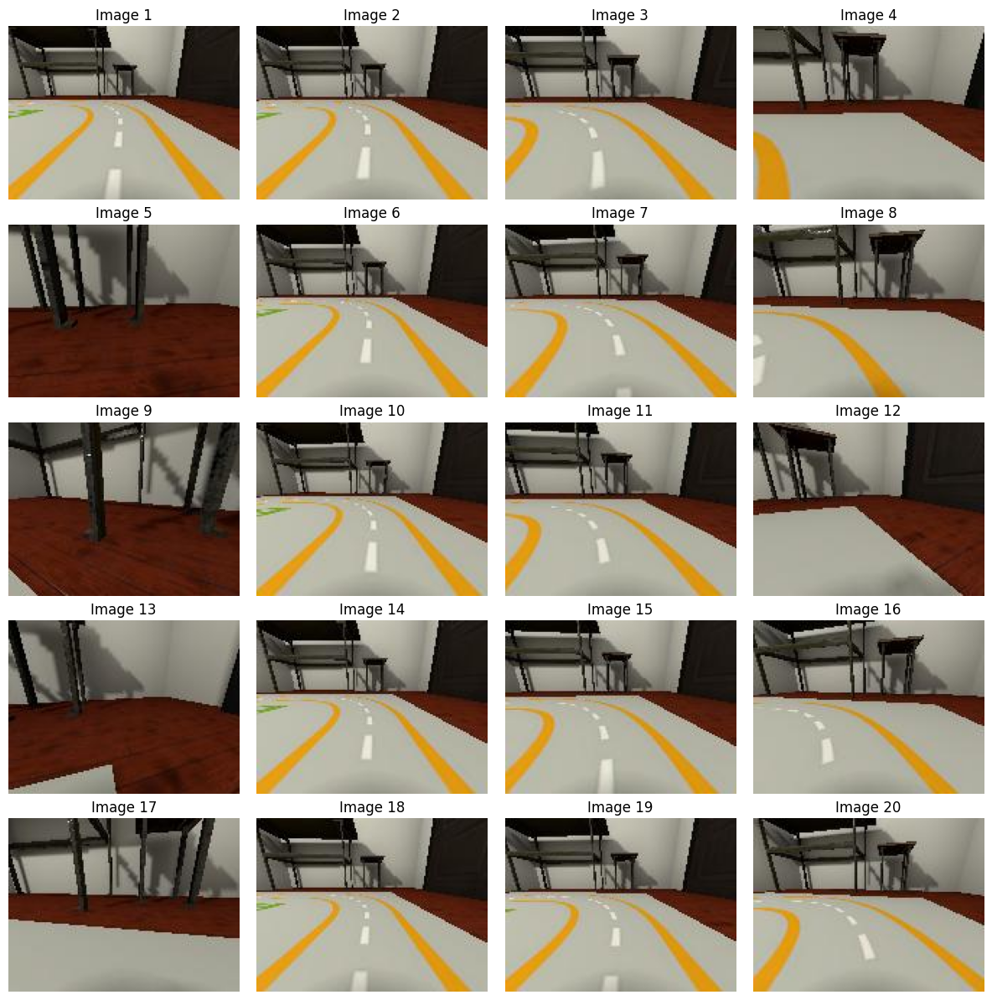

In [3]:
images = []

obs = env.reset()

for step in range(200):
    action = env.action_space.sample()
    obs, _, done, _ = env.step(action)

    if step % 10 == 0:  # capture every 10th step
        images.append(obs)

    if done:
        obs = env.reset()

n = len(images)
cols = 4
rows = (n + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(12, 12))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < n:
        ax.imshow(images[i])
        ax.set_title(f"Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Path Visualization

### Image Processor Initialization

In [4]:
image_processor = ImageProcessor(0.25, 84, 100) # 25% top cropping, 84x84 resize, 100% augmentation

🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-18-50 every 1000 frames.


### Line drawer config parameters

In [5]:
# Steering parameters
STEERING_CONFIG: LineDrawerParams = {
    "image_processing_args": (0.25, 84, 1.0),
    "num_lines": 19,
    "radius_from": 15,
    "skip_lines": 1,
    "edge_strategy": "roll",
    "distance": 1.5,
    "sqr_derivs": True,
    "use_global": False,
    "basis": "channels", 
    "roll_window": 3,
    "scale_roll": True,
    "combine_lines": "max",
}

# Throttle parameters
THROTTLE_CONFIG: LineDrawerParams = {
    "image_processing_args": (0.25, 84, 1.0),
    "num_lines": 14,
    "radius_from": 15,
    "skip_lines": 1,
    "edge_strategy": "roll",
    "distance": 1.5,
    "sqr_derivs": True,
    "use_global": False,
    "basis": "channels",
    "roll_window": 3,
    "scale_roll": True,
    "combine_lines": "max",
}

### Path Visualization Function

In [6]:
def path_visualization(image, steering_config, throttle_config, title, steering_cmap="viridis", throttle_cmap="plasma"):
    """
    Visualize steering and throttle paths and target points side by side on the given image.
    
    Args:
        image (np.ndarray): The image to visualize paths on.
        steering_config (dict): Configuration parameters for steering path visualization.
        throttle_config (dict): Configuration parameters for throttle path visualization.
        title (str): Figure title.
        steering_cmap (str): Colormap for steering paths.
        throttle_cmap (str): Colormap for throttle paths.
    
    Returns:
        dict: Contains source point, steering paths, throttle paths, distances, and target points.
    """
    fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharex=False, sharey=True)
    fig.suptitle(title, fontsize=16)
    
    # Get image dimensions
    height, width = image.shape[:2] # HWC format
    print(f"Image dimensions: height={height}, width={width}")

    # Define source point:
    source_point = (width // 2, height - 1)

    # Initialize PathCalculator
    path_calculator = PathCalculator(width, height)

    def _extract_paths_and_targets(config):        
        """Get paths, distances, and target names"""
        paths, distances, target_names = path_calculator.get_paths(
            num_lines=config["num_lines"],
            radius_from=config["radius_from"],
            skip_lines=config["skip_lines"]
            )
        
        # Parse target points from target_names
        target_points = []
        for name in target_names:
            name = name.strip('()')
            x_str, y_str = name.split(',')
            x = int(x_str.strip())
            y = int(y_str.strip())
            target_points.append((x, y))
        return paths, distances, target_points

    def _sub_plot(ax, subplot_name, config, cmap_name, marker, edge_color, label_prefix):
        """Create a sub-plot for the given configuration."""
        ax.imshow(image)

        # Plot source point
        ax.scatter(
            source_point[0], source_point[1],
            c="red", s=200, marker="*",
            edgecolors="white", linewidth=2.0, zorder=6,
            label=f"Source {source_point}"
        )

        # Extract paths and targets
        paths, distances, target_points = _extract_paths_and_targets(config)

        # Generate colors
        colors = plt.cm.get_cmap(cmap_name)(np.linspace(0, 1, len(paths)))

        # Plot paths and target points
        for idx, (path, target, color) in enumerate(zip(paths, target_points, colors), start=1):
            if len(path[0]) == 0:
                continue
            coords = np.column_stack([path[0], path[1]])

            # Plot paths
            ax.plot(
                coords[:, 0], coords[:, 1],
                color=color, linewidth=2.0, alpha=1.0, zorder=3
            )

            # Plot target points
            ax.scatter(
                target[0], target[1],
                c=[color], s=120, marker=marker,
                edgecolors=edge_color, linewidth=1.5, zorder=4
            )

            # Annotate target points
            ax.annotate(
                f"{label_prefix}{idx}\n({target[0]}, {target[1]})",
                xy=target, xytext=(6, 6), textcoords="offset points",
                fontsize=8, fontweight="bold", color="white",
                bbox=dict(boxstyle="round, pad=0.25", facecolor="black", alpha=1),
                zorder=5
            )

        # Set titles and labels
        ax.set_title(f"{subplot_name} Paths ({len(paths)} lines)", pad=25)
        ax.set_xlabel("X (pixels)")
        ax.set_ylabel("Y (pixels)")
        ax.grid(True, alpha=0.3)

        ax.legend(loc="lower left", framealpha=0.75)

        return {
            "paths": paths,
            "distances": distances,
            "target_points": target_points
        }

    steering_info = _sub_plot(
        axes[0], "Steering", steering_config,
        steering_cmap, marker="o", edge_color="black", label_prefix="S"
    )
    throttle_info = _sub_plot(
        axes[1], "Throttle", throttle_config,
        throttle_cmap, marker="o", edge_color="black", label_prefix="T"
    )

    plt.tight_layout()
    plt.show()

    return {
        "source_point": source_point,
        "steering": steering_info,
        "throttle": throttle_info,
    }    

### Visualize Steering and Throttle Paths

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


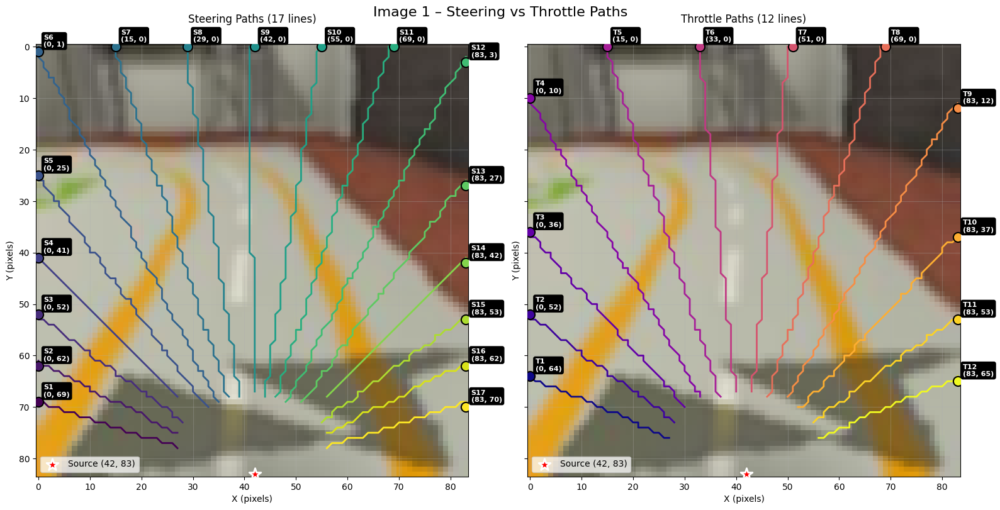

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


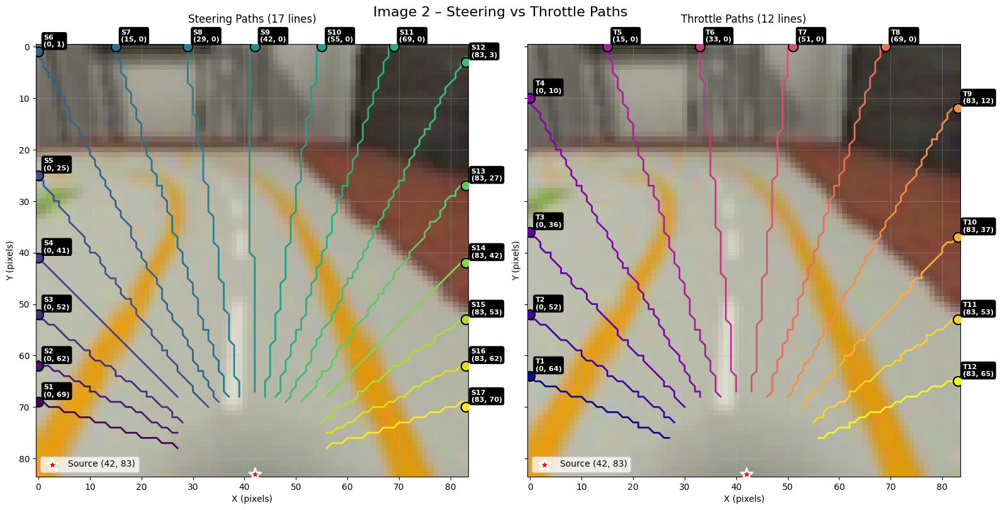

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


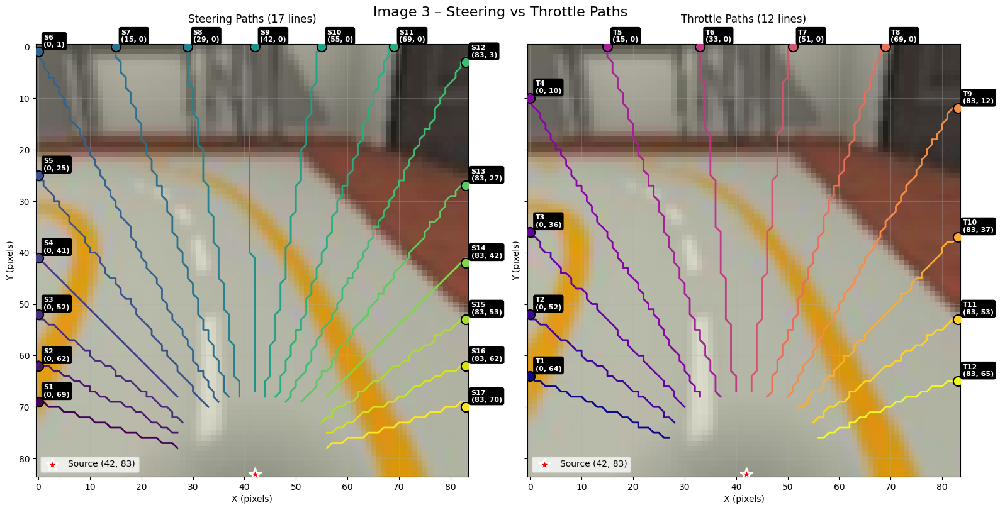

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


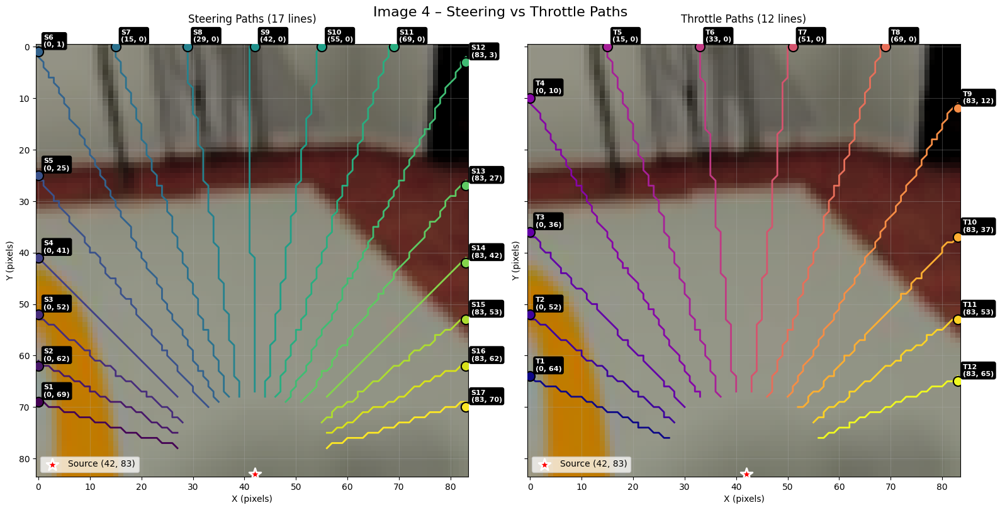

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


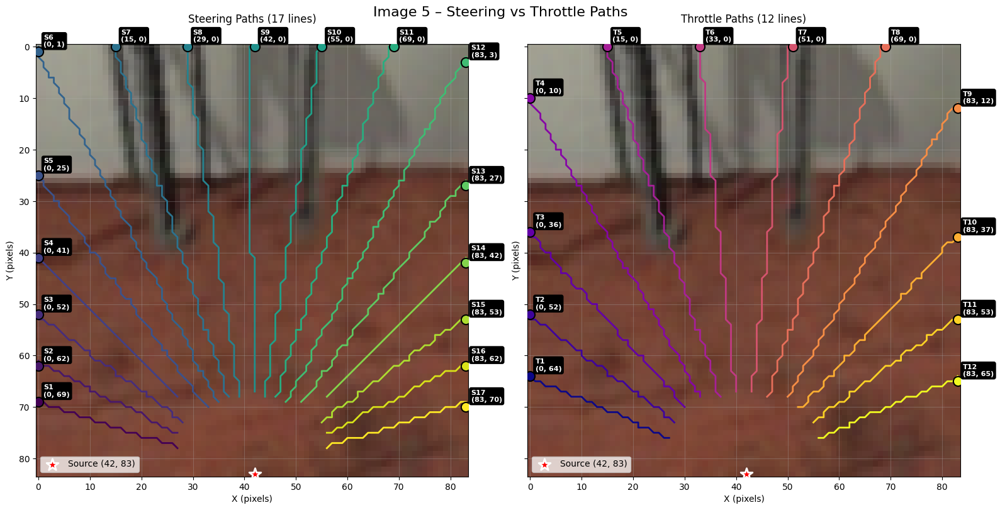

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


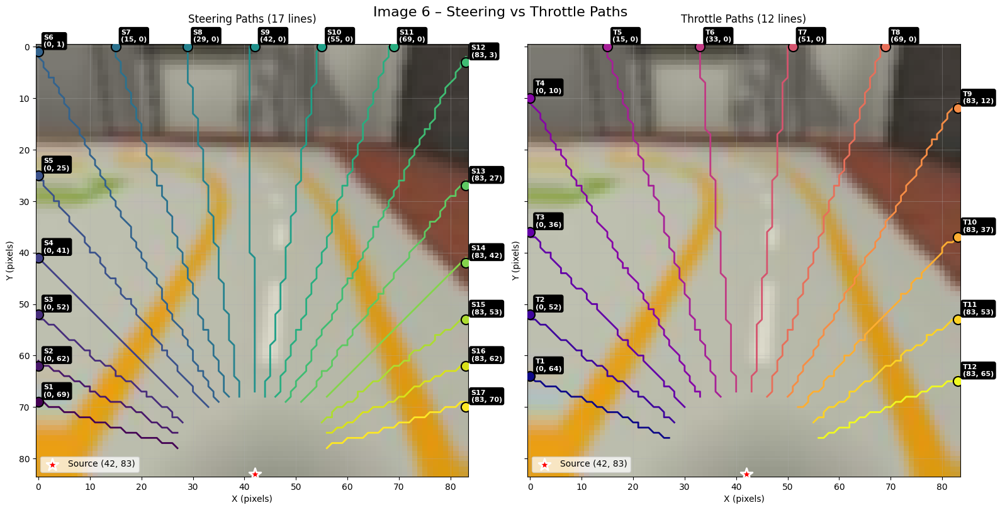

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


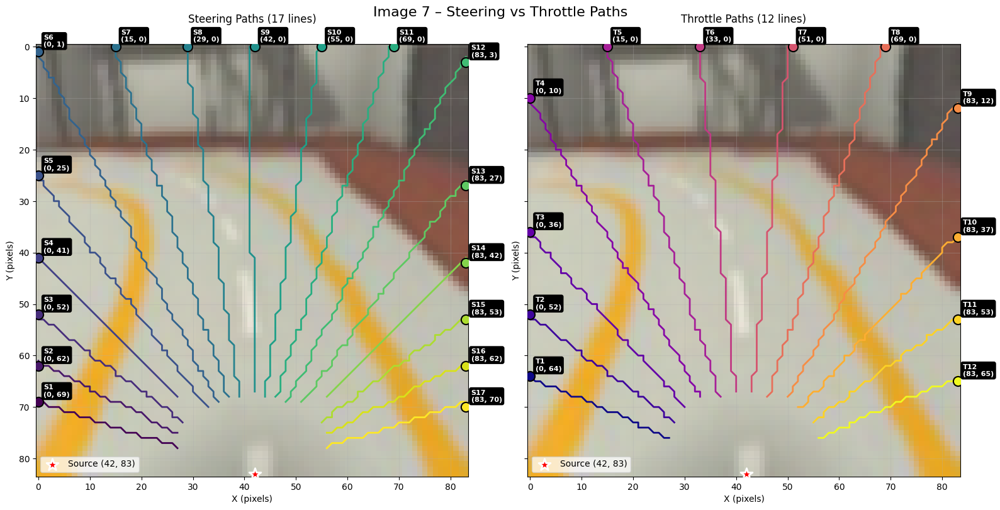

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


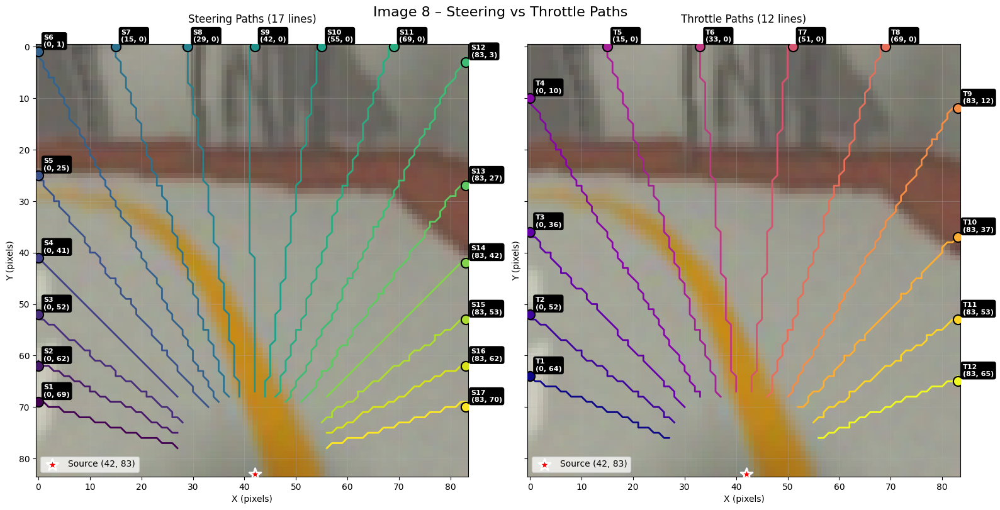

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


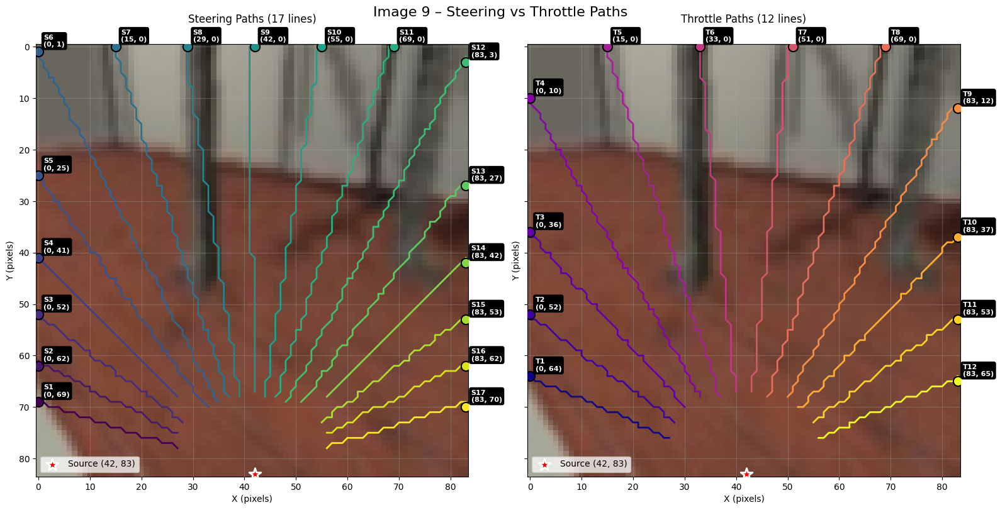

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


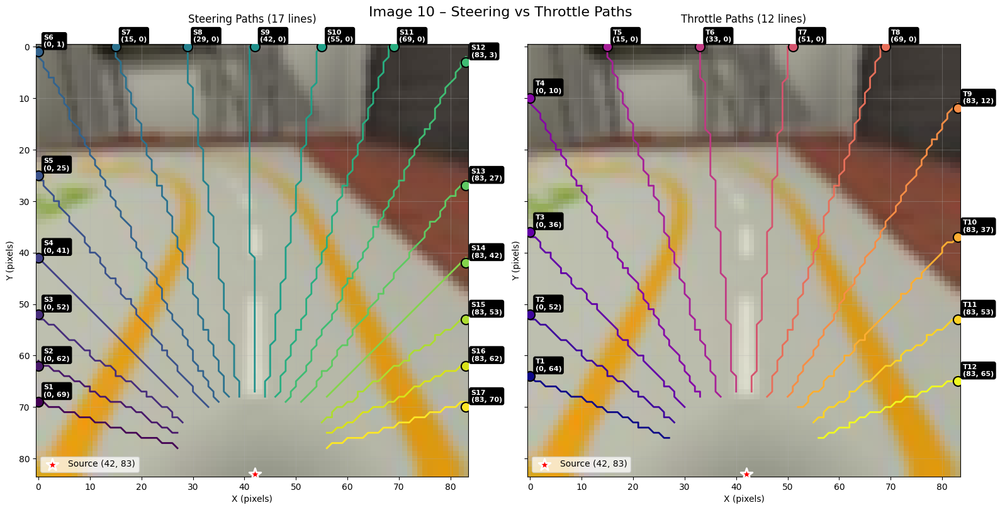

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


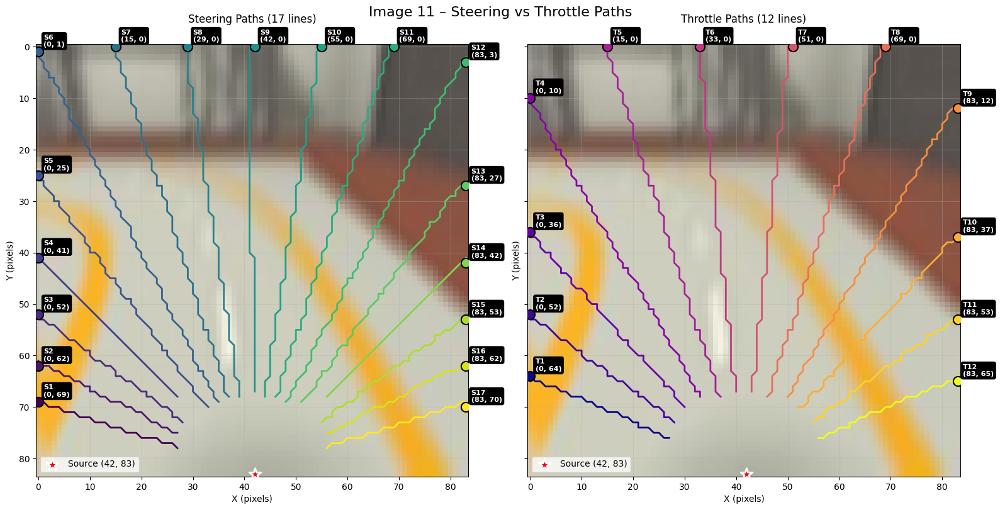

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


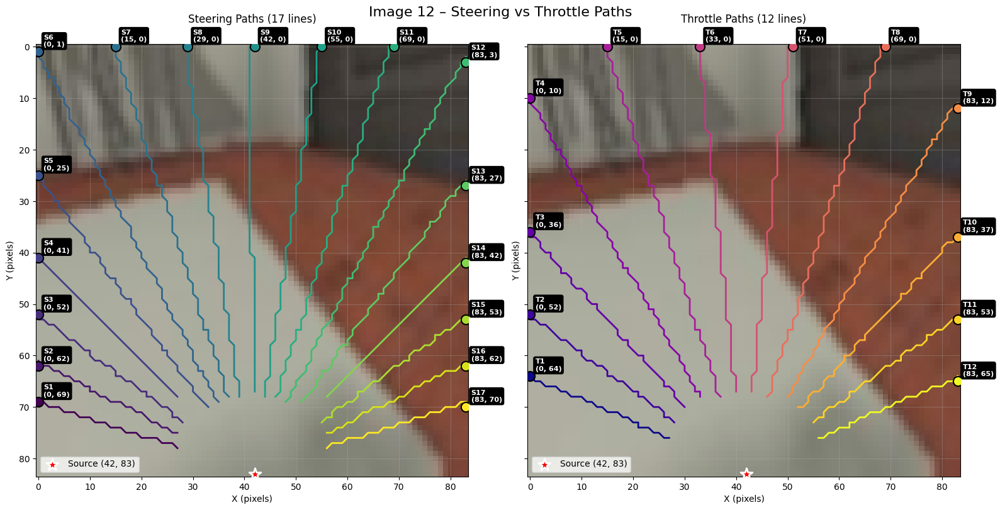

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


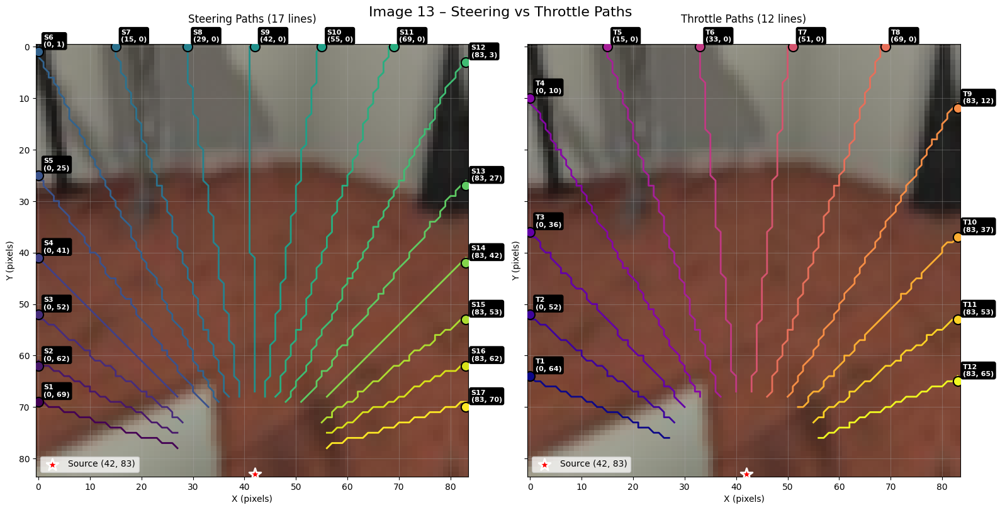

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


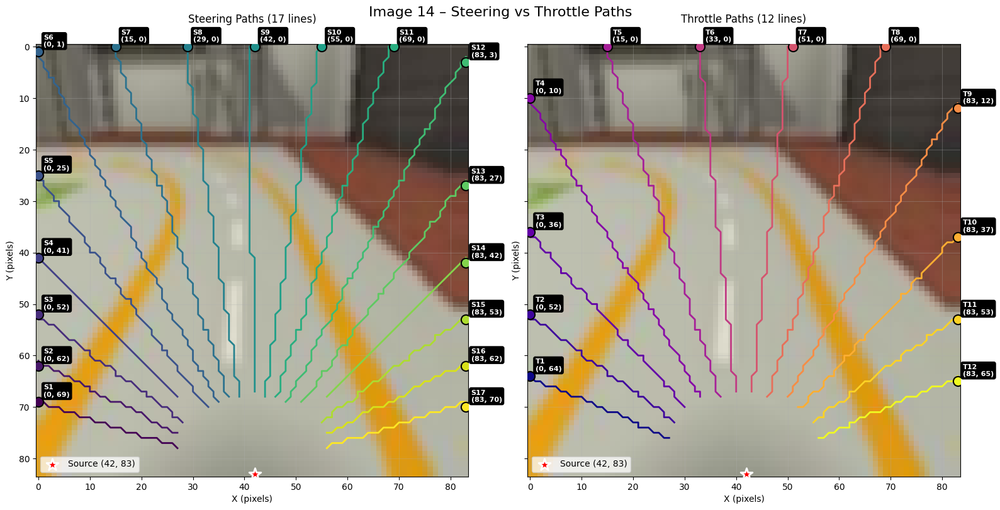

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


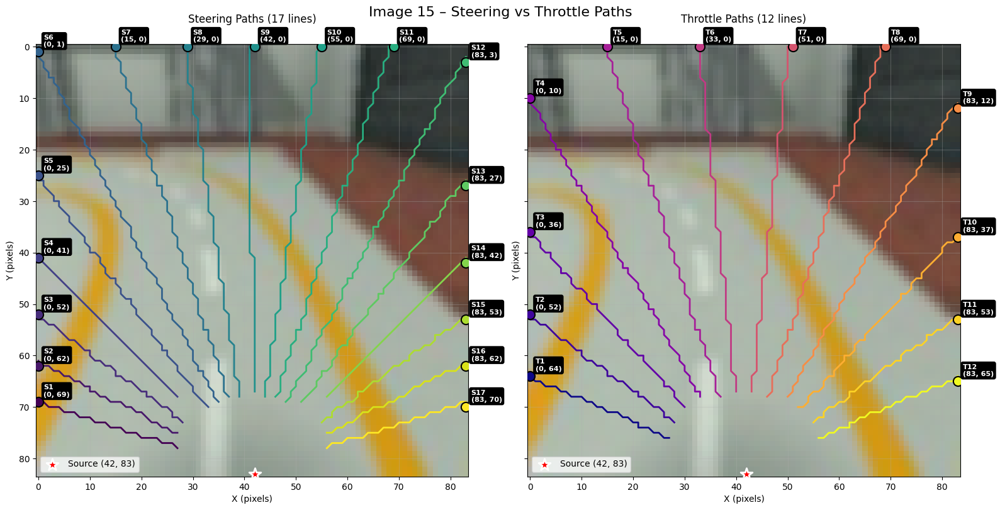

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


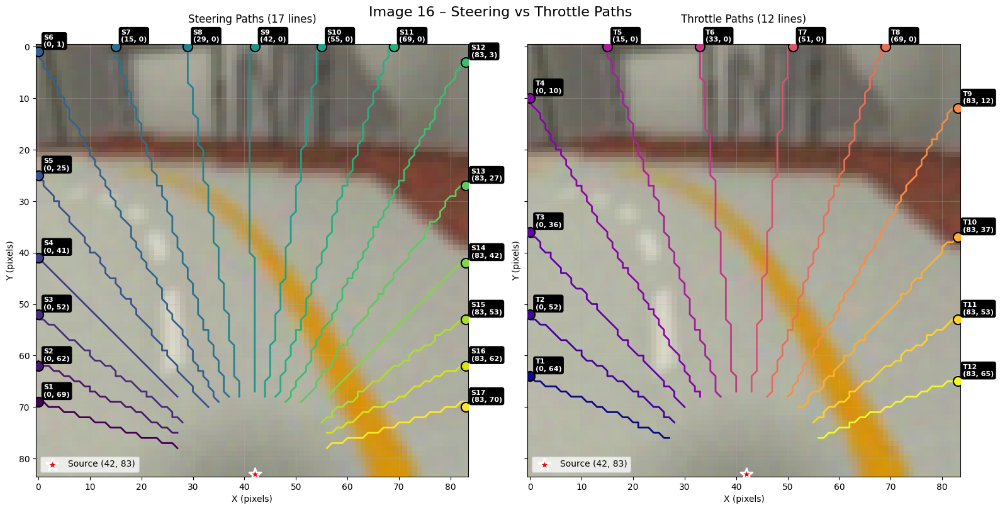

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


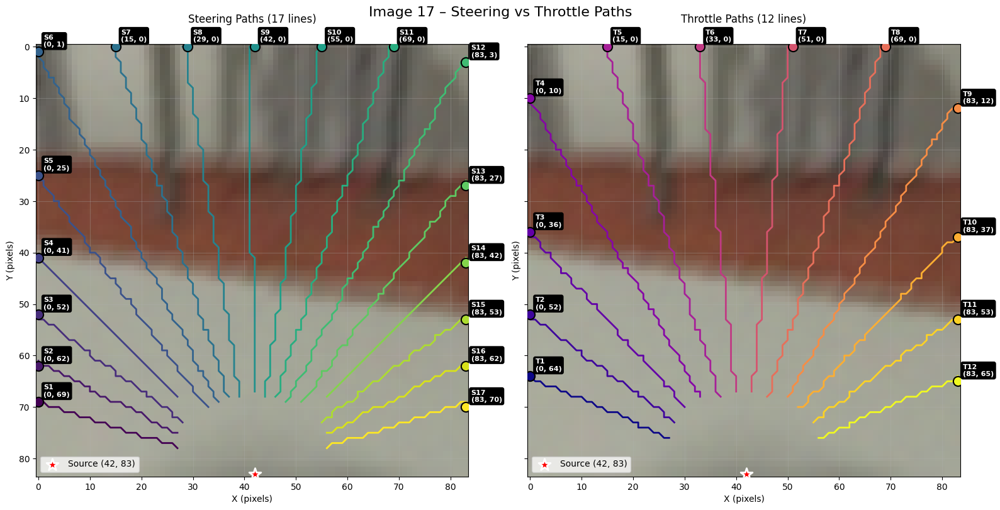

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


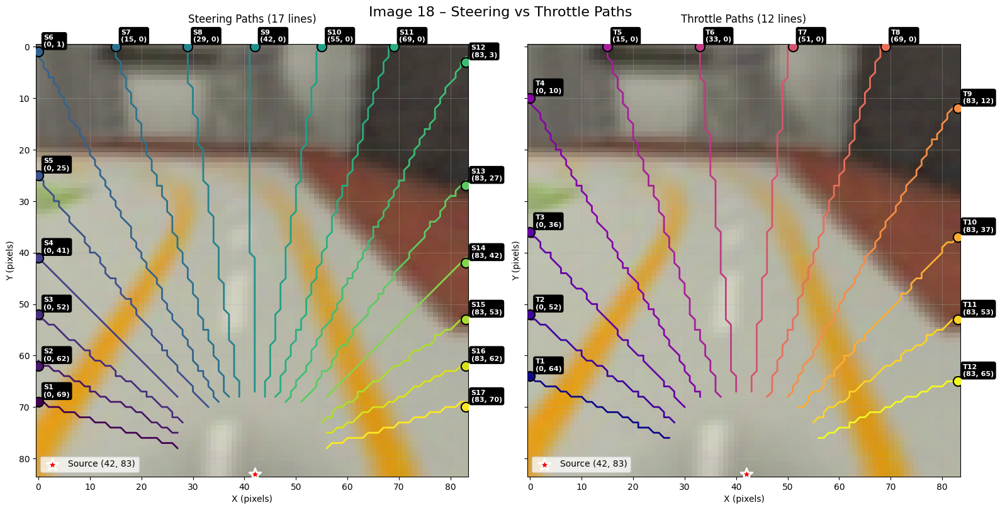

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


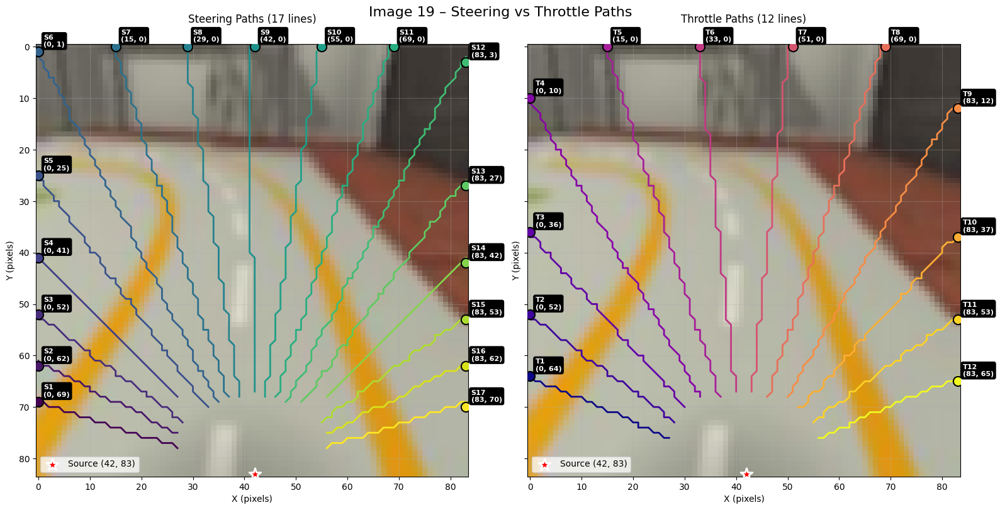

Image dimensions: height=84, width=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)


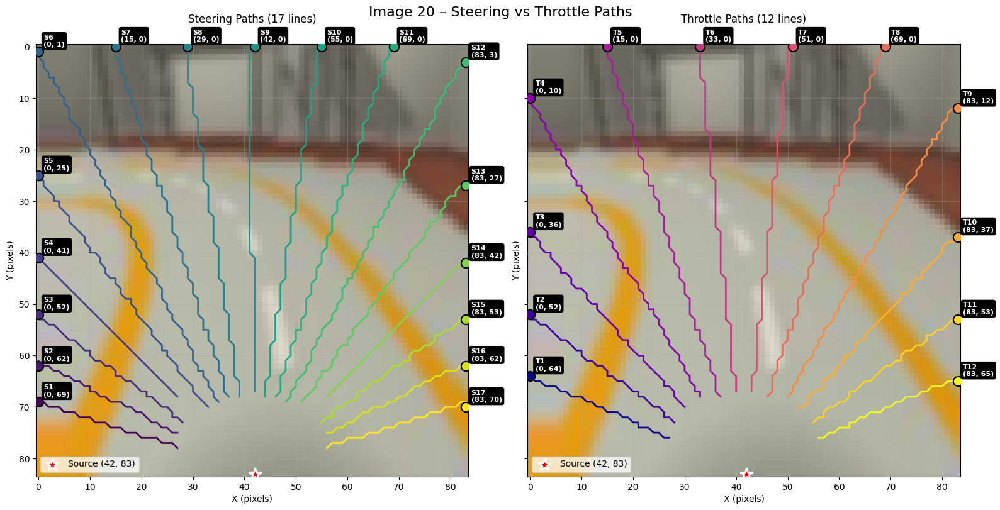

In [7]:
for idx, img in enumerate(images, start=1) :
    # Process image (crop, resize, augment, gaussian blur, shadow/ highlight correction)
    processed_img = image_processor.process_image(img)
    
    # Call path visualization function
    path_visualization(
        processed_img,
        steering_config=STEERING_CONFIG,
        throttle_config=THROTTLE_CONFIG,
        title=f"Image {idx} – Steering vs Throttle Paths"
    )

## Edge Detection

In [8]:
def to_python_coords(edges):
    """Convert detected edges from np.int64/float64 to native Python int/float format."""
    coords = []
    for edge in edges:
        if edge is None:
            continue
        try:
            x, y, distance = edge
        except (TypeError, ValueError):
            # Skip malformed entries
            continue
        coords.append([int(x), int(y), float(distance)])
    return coords

### Edge Detection Strategy Comparison - Separated Steering and Throttle Edges

🔍 Running edge detection for all strategies...
   Processing IQR strategy...
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-10 every 1000 frames.

🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-10 every 1000 frames.
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄

✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄

🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄

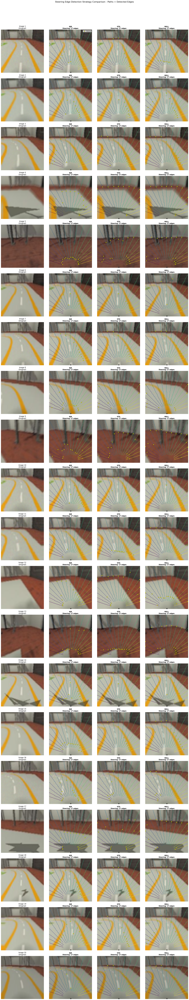

🎨 Creating throttle paths and edges visualization for 20 images...
Drawing paths on image of size: width=84, height=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
Drawing paths on image of size: width=84, height=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
Drawing paths on image of size: width=84, height=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
Drawing paths on image of size: width=84, height=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
Drawing paths on image of size: width=84, height=84
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  S

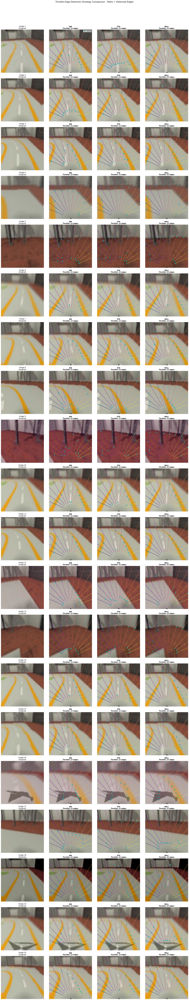

In [9]:
def edge_detection_strategy_comparison_separated():
    """
    Edge detection strategy comparison with separate steering and throttle paths and edges visualizations.
    Creates two sets of plots:
    1st set: Steering paths and edges (Original | IQR | STD | ROLL)
    2nd set: Throttle paths and edges (Original | IQR | STD | ROLL)
    """
    
    # Edge detection strategies
    strategies = ["iqr", "std", "roll"]
    
    def draw_scan_paths(ax, image, config, color_map="viridis", alpha=0.6, linewidth=1.5):
        """Draw scan line paths on the given axis"""
        height, width = image.shape[:2]
        print(f"Drawing paths on image of size: width={width}, height={height}")
        path_calculator = PathCalculator(width, height)
        paths, _, _ = path_calculator.get_paths(
            num_lines=config["num_lines"],
            radius_from=config["radius_from"],
            skip_lines=config["skip_lines"],
        )
        
        # Draw paths with different colors
        colors = plt.cm.get_cmap(color_map)(np.linspace(0, 1, len(paths)))
        for path, color in zip(paths, colors):
            coords = np.column_stack([path[0], path[1]])
            ax.plot(coords[:, 0], coords[:, 1], color=color, linewidth=linewidth, alpha=alpha)
        
        # Mark source point
        source_point = (width // 2, height - 1)
        ax.scatter(source_point[0], source_point[1], c="white", s=80, marker="*", 
                  edgecolors="black", linewidth=1.5, zorder=5)
    
    def extract_edge_coordinates(edges):
        """Extract x, y coordinates from edge tuples"""
        if not edges:
            return [], []
        x_coords, y_coords = [], []
        for edge in edges:
            if edge is not None and len(edge) == 3:
                x_coords.append(edge[0])
                y_coords.append(edge[1])
        return x_coords, y_coords
    
    def create_subplot_set(plot_type, edges_key, config_base, color_map, edge_color, marker, title_suffix):
        """Create a complete subplot set for either steering or throttle"""
        
        num_images = len(images)
        fig, axes = plt.subplots(num_images, 4, figsize=(20, 5 * num_images))
        
        # Handle single image case
        if num_images == 1:
            axes = axes.reshape(1, -1)
        
        for img_idx, raw_img in enumerate(images):
            # Process image
            processed_img = image_processor.process_image(raw_img)
            
            # Column 0: Original image
            axes[img_idx, 0].imshow(processed_img)
            axes[img_idx, 0].set_title(f"Image {img_idx + 1}\n(Original)")
            axes[img_idx, 0].axis('off')
            
            # Columns 1-3: Strategy results for this specific control type (steering or throttle)
            for strategy_idx, strategy in enumerate(strategies):
                ax = axes[img_idx, strategy_idx + 1]
                ax.imshow(processed_img)
                
                # Create strategy-specific config
                config = config_base.copy()
                config['edge_strategy'] = strategy
                
                # Draw paths
                draw_scan_paths(ax, processed_img, config, color_map, alpha=0.7, linewidth=1.5)
                
                # Plot detected edges
                if img_idx < len(all_results[strategy]):
                    img_result = all_results[strategy][img_idx]
                    
                    # Get edges for the image and control type
                    edges = img_result[edges_key]
                    edge_x, edge_y = extract_edge_coordinates(edges)
                    
                    if edge_x:
                        ax.scatter(edge_x, edge_y, c=edge_color, s=35, marker=marker,
                                 edgecolors='black', linewidth=0.6, alpha=0.95, 
                                 label=plot_type.title(), zorder=6)
                    
                    # Set title with edge count for this type
                    count = img_result[f'{edges_key.split("_")[0]}_count']
                    title = f"{strategy.upper()}\n{plot_type.title()}: {count} edges"
                    ax.set_title(title, fontsize=11, fontweight='bold')
                    
                    # Add legend only for first image, first strategy
                    if img_idx == 0 and strategy_idx == 0:
                        handles, labels = ax.get_legend_handles_labels()
                        if handles:
                            ax.legend(handles, labels, fontsize=8, loc='upper right', framealpha=0.7)
                
                ax.axis('off')
        
        plt.suptitle(f"{plot_type.title()} Edge Detection Strategy Comparison{title_suffix}", 
                    fontsize=16, y=1.02)
        plt.tight_layout()
        plt.show()
    
    # Run edge detection for all strategies
    print("🔍 Running edge detection for all strategies...")
    all_results = {}
    
    for strategy in strategies:
        print(f"   Processing {strategy.upper()} strategy...")
        
        # Create strategy-specific configs
        steering_params = STEERING_CONFIG.copy()
        steering_params['edge_strategy'] = strategy
        throttle_params = THROTTLE_CONFIG.copy()
        throttle_params['edge_strategy'] = strategy
        
        # Initialize line drawer
        line_drawer = ParallelLineDrawer(
            steering_kwargs=steering_params,
            throttle_kwargs=throttle_params
        )
        
        strategy_results = []
        for idx, img in enumerate(images):
            steering_edges, throttle_edges = line_drawer.get_edges(img)
            strategy_results.append({
                "steering_edges": steering_edges,
                "throttle_edges": throttle_edges,
                "steering_count": len(steering_edges),
                "throttle_count": len(throttle_edges)
            })
        
        all_results[strategy] = strategy_results
        line_drawer.cleanup()
    
    print("✅ Edge detection complete!")
    
    # Create separate visualizations
    print(f"🎨 Creating steering paths and edges visualization for {len(images)} images...")
    create_subplot_set(
        plot_type="steering",
        edges_key="steering_edges", 
        config_base=STEERING_CONFIG,
        color_map="viridis",
        edge_color="yellow",
        marker="o",
        title_suffix=" - Paths + Detected Edges"
    )
    
    print(f"🎨 Creating throttle paths and edges visualization for {len(images)} images...")
    create_subplot_set(
        plot_type="throttle",
        edges_key="throttle_edges",
        config_base=THROTTLE_CONFIG, 
        color_map="plasma",
        edge_color="cyan",
        marker="s",
        title_suffix=" - Paths + Detected Edges"
    )

if __name__ == "__main__":
    edge_detection_strategy_comparison_separated()

### Edge Detection Strategy Comparison - Combined Steering and Throttle Edges

🔍 Running edge detection for all strategies...
   Processing IQR strategy...
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄

🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-22 every 1000 frames.

🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-22 every 1000 frames.
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄📍  Source point: (42, 83)

✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄

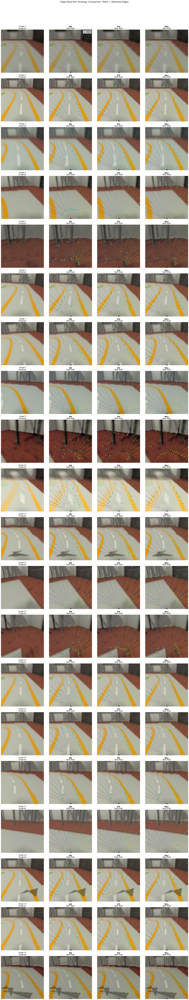

In [10]:
def edge_detection_strategy_comparison():
    """
    Edge detection strategy comparison with path and edge visualization.
    Creates one row per image showing: Original | IQR | STD | ROLL
    """
    
    # Edge detection strategies
    strategies = ["iqr", "std", "roll"]
    
    def draw_scan_paths(ax, image, config, color_map="viridis", alpha=0.6, linewidth=1.2):
        """Draw scan line paths on the given axis"""
        height, width = image.shape[:2]
        path_calculator = PathCalculator(width, height)
        paths, _, _ = path_calculator.get_paths(
            num_lines=config["num_lines"],
            radius_from=config["radius_from"],
            skip_lines=config["skip_lines"],
        )
        
        # Draw paths with different colors
        colors = plt.cm.get_cmap(color_map)(np.linspace(0, 1, len(paths)))
        for path, color in zip(paths, colors):
            coords = np.column_stack([path[0], path[1]])
            ax.plot(coords[:, 0], coords[:, 1], color=color, linewidth=linewidth, alpha=alpha)
        
        # Mark source point
        source_point = (width // 2, height - 1)
        ax.scatter(source_point[0], source_point[1], c="white", s=80, marker="*", 
                  edgecolors="black", linewidth=1.5, zorder=5)
    
    def extract_edge_coordinates(edges):
        """Extract x, y coordinates from edge tuples"""
        if not edges:
            return [], []
        x_coords, y_coords = [], []
        for edge in edges:
            if edge is not None and len(edge) == 3:
                x_coords.append(edge[0])
                y_coords.append(edge[1])
        return x_coords, y_coords
    
    # Run edge detection for all strategies
    print("🔍 Running edge detection for all strategies...")
    all_results = {}
    
    for strategy in strategies:
        print(f"   Processing {strategy.upper()} strategy...")
        
        # Create strategy-specific configs
        steering_params = STEERING_CONFIG.copy()
        steering_params['edge_strategy'] = strategy
        throttle_params = THROTTLE_CONFIG.copy()
        throttle_params['edge_strategy'] = strategy
        
        # Initialize line drawer
        line_drawer = ParallelLineDrawer(
            steering_kwargs=steering_params,
            throttle_kwargs=throttle_params
        )
        
        strategy_results = []
        for idx, img in enumerate(images):
            steering_edges, throttle_edges = line_drawer.get_edges(img)
            strategy_results.append({
                "steering_edges": steering_edges,
                "throttle_edges": throttle_edges,
                "steering_count": len(steering_edges),
                "throttle_count": len(throttle_edges)
            })
        
        all_results[strategy] = strategy_results
        line_drawer.cleanup()
    
    print("✅ Edge detection complete!")
    
    # Create visualization
    print(f"🎨 Creating comparison visualization for {len(images)} images...")
    
    num_images = len(images)
    fig, axes = plt.subplots(num_images, 4, figsize=(20, 5 * num_images))
    
    # Handle single image case
    if num_images == 1:
        axes = axes.reshape(1, -1)
    
    for img_idx, raw_img in enumerate(images):
        # Process image
        processed_img = image_processor.process_image(raw_img)
        
        # Column 0: Original image
        axes[img_idx, 0].imshow(processed_img)
        axes[img_idx, 0].set_title(f"Image {img_idx + 1}\n(Original)")
        axes[img_idx, 0].axis('off')
        
        # Columns 1-3: Strategy results
        for strategy_idx, strategy in enumerate(strategies):
            ax = axes[img_idx, strategy_idx + 1]
            ax.imshow(processed_img)
            
            # Draw scan paths for both steering and throttle
            steering_cfg = STEERING_CONFIG.copy()
            steering_cfg['edge_strategy'] = strategy
            throttle_cfg = THROTTLE_CONFIG.copy()
            throttle_cfg['edge_strategy'] = strategy
            
            # Draw steering paths (viridis colormap)
            draw_scan_paths(ax, processed_img, steering_cfg, "viridis", alpha=0.5, linewidth=1.0)
            
            # Draw throttle paths (plasma colormap)
            draw_scan_paths(ax, processed_img, throttle_cfg, "plasma", alpha=0.4, linewidth=0.8)
            
            # Plot detected edges
            if img_idx < len(all_results[strategy]):
                result = all_results[strategy][img_idx]
                
                # Steering edges (yellow circles)
                steering_x, steering_y = extract_edge_coordinates(result['steering_edges'])
                if steering_x:
                    ax.scatter(steering_x, steering_y, c='yellow', s=30, marker='o',
                             edgecolors='black', linewidth=0.5, alpha=0.9, 
                             label='Steering', zorder=6)
                
                # Throttle edges (cyan squares)
                throttle_x, throttle_y = extract_edge_coordinates(result['throttle_edges'])
                if throttle_x:
                    ax.scatter(throttle_x, throttle_y, c='cyan', s=30, marker='s',
                             edgecolors='black', linewidth=0.5, alpha=0.8,
                             label='Throttle', zorder=6)
                
                # Set title with edge counts
                title = f"{strategy.upper()}\nS:{result['steering_count']} T:{result['throttle_count']}"
                ax.set_title(title, fontsize=11, fontweight='bold')
                
                # Add legend only for first image, first strategy
                if img_idx == 0 and strategy_idx == 0:
                    handles, labels = ax.get_legend_handles_labels()
                    if handles:
                        ax.legend(handles, labels, fontsize=8, loc='upper right', framealpha=0.7)
            
            ax.axis('off')
    
    plt.suptitle("Edge Detection Strategy Comparison: Paths + Detected Edges", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    edge_detection_strategy_comparison()

## Test the Performance of Different Edge Detection Strategies


 Testing IQR strategy...
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-32 every 1000 frames.

🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-32 every 1000 frames.
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄

✅ Path calculator initialized for 84x84 images✅ Path calculator initialized for 84x84 images

📍  Source point: (42, 83)📍  Source point: (42, 83)

🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄

   ✅ Saved 20 image edges to 'edge_results/iqr'

 

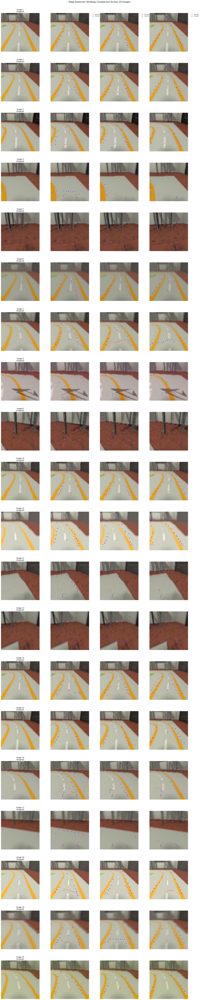

In [11]:
# Define test strategies
strategies = ['iqr', 'std', 'roll']

result_dir = "edge_results"
os.makedirs(result_dir, exist_ok=True)

strategy_comparison = {}

def extract_edge_coords(edges):
    """Extract x, y coordinates from edge list"""
    x_coords = [edge[0] for edge in edges if edge is not None and len(edge) == 3]
    y_coords = [edge[1] for edge in edges if edge is not None and len(edge) == 3]
    return x_coords, y_coords

# Run edge detection and save results
for strategy in strategies:
    print(f"\n Testing {strategy.upper()} strategy...")

    try:
        # Prepare folders
        strategy_folder = os.path.join(result_dir, strategy)
        os.makedirs(strategy_folder, exist_ok=True)

        # Prepare configs
        steering_params = STEERING_CONFIG.copy()
        steering_params['edge_strategy'] = strategy

        throttle_params = THROTTLE_CONFIG.copy()
        throttle_params['edge_strategy'] = strategy

        # Line drawer for this strategy
        line_drawer = ParallelLineDrawer(
            steering_kwargs=steering_params,
            throttle_kwargs=throttle_params
        )

        strategy_results = []

        for idx, img in enumerate(images):
            steering_edges, throttle_edges = line_drawer.get_edges(img)

            # Save edges to JSON for this image
            image_edges = {
                "image_index": idx,
                "steering_edges": to_python_coords(steering_edges),
                "throttle_edges": to_python_coords(throttle_edges)
            }
            strategy_results.append(image_edges)

            json_path = os.path.join(strategy_folder, f"{strategy}_edges_{idx:03d}.json")
            with open(json_path, "w") as f:
                json.dump(image_edges, f, indent=2)

        # Store in comparison dictionary
        strategy_comparison[strategy] = {
            "results": strategy_results,
            "total_steering_edges": sum(len(r["steering_edges"]) for r in strategy_results),
            "total_throttle_edges": sum(len(r["throttle_edges"]) for r in strategy_results)
        }

        line_drawer.cleanup()
        print(f"   ✅ Saved {len(strategy_results)} image edges to '{strategy_folder}'")

    except Exception as e:
        print(f"   ❌ Error: {e}")
        strategy_comparison[strategy] = {"error": str(e)}

print("\n✅ Strategy comparison complete!")
print(f"   Tested {len(strategies)} strategies")
print(f"   Successful: {len([s for s in strategy_comparison.values() if 'error' not in s])}")

# Summary
for strategy, data in strategy_comparison.items():
    if "error" in data:
        print(f"   {strategy.upper()}: ❌ {data['error']}")
    else:
        print(f"   {strategy.upper()}: ✅ {data['total_steering_edges']} steering edges | "
              f"{data['total_throttle_edges']} throttle edges")

# Visualization
print(f"\n🎨 Generating visualizations for {len(images)} images...")

# Create subplot grid: one row per image, 4 columns (original + 3 strategies)
num_images = len(images)
fig, axes = plt.subplots(num_images, 4, figsize=(20, 5 * num_images))

# Handle single image case
if num_images == 1:
    axes = axes.reshape(1, -1)

for img_idx, img in enumerate(images):
    processed_img = image_processor.process_image(img)
    
    # Display original image in the first column
    axes[img_idx, 0].imshow(processed_img)
    axes[img_idx, 0].set_title(f"Image {img_idx + 1}\n(Original)")
    axes[img_idx, 0].axis('off')
    
    # Display results for each strategy
    for strategy_idx, strategy in enumerate(strategies):
        ax = axes[img_idx, strategy_idx + 1]
        ax.imshow(processed_img)
        
        img_result = strategy_comparison[strategy]['results'][img_idx]
        
        if 'error' not in img_result:
            # Plot steering edges in red
            steering_x, steering_y = extract_edge_coords(img_result['steering_edges'])
            if steering_x:
                ax.scatter(steering_x, steering_y, c='red', s=25, alpha=0.8, 
                          edgecolors='white', linewidth=0.5, label='Steering')
            
            # Plot throttle edges in blue
            throttle_x, throttle_y = extract_edge_coords(img_result['throttle_edges'])
            if throttle_x:
                ax.scatter(throttle_x, throttle_y, c='blue', s=25, alpha=0.8,
                          edgecolors='white', linewidth=0.5, label='Throttle')
            
            # Add legend only for first image
            if img_idx == 0 and (steering_x or throttle_x):
                ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
        else:
            ax.set_title(f"{strategy.upper()}\n❌ Error", fontsize=11, fontweight='bold')
                
        ax.axis('off')

plt.suptitle(f"Edge Detection Strategy Comparison Across {len(images)} Images", fontsize=16, y=1)
plt.tight_layout()
plt.show()

📁 Results will be saved to: edge_results/run_2026-01-01_20-19-37

🔍 Testing IQR strategy...
🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄
🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-38 every 1000 frames.🔄🔄🔄🔄🔄 CALLFLOW: Entering line_drawer.py - Line Drawer(s) Setup 🔄🔄🔄🔄🔄

🔄🔄🔄🔄🔄 CALLFLOW: Entering image_processor.py - Image Processing Pipeline 🔄🔄🔄🔄🔄
💾 Raw and processed images will be saved to saved_images/run_2026-01-01_20-19-38 every 1000 frames.
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images
📍  Source point: (42, 83)
🔄🔄🔄🔄🔄 CALLFLOW: Entering paths.py - Generic Path Calculator 🔄🔄🔄🔄🔄
✅ Path calculator initialized for 84x84 images🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge Detection 🔄🔄🔄🔄🔄

📍  Source point: (42, 83)
🔄🔄🔄🔄🔄 CALLFLOW: Entering edge_detector.py - Track Lane Edge 

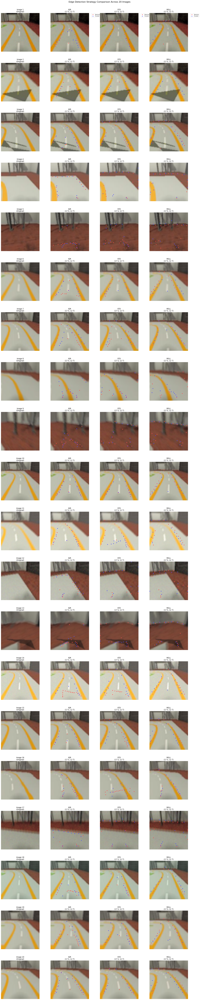

In [12]:
# Define test strategies
strategies = ['iqr', 'std', 'roll']

# Create timestamped result directory
timestamp = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
result_dir = os.path.join("edge_results", f"run_{timestamp}")
os.makedirs(result_dir, exist_ok=True)

print(f"📁 Results will be saved to: {result_dir}")

strategy_comparison = {}

def extract_edge_coords(edges):
    """Extract x, y coordinates from edge list"""
    x_coords = [edge[0] for edge in edges if edge is not None and len(edge) == 3]
    y_coords = [edge[1] for edge in edges if edge is not None and len(edge) == 3]
    return x_coords, y_coords

# Run edge detection and save results
for strategy in strategies:
    print(f"\n🔍 Testing {strategy.upper()} strategy...")

    try:
        # Prepare folders
        strategy_folder = os.path.join(result_dir, strategy)
        os.makedirs(strategy_folder, exist_ok=True)

        # Prepare configs
        steering_params = STEERING_CONFIG.copy()
        steering_params['edge_strategy'] = strategy

        throttle_params = THROTTLE_CONFIG.copy()
        throttle_params['edge_strategy'] = strategy

        # Line drawer for this strategy
        line_drawer = ParallelLineDrawer(
            steering_kwargs=steering_params,
            throttle_kwargs=throttle_params
        )

        strategy_results = []

        for idx, img in enumerate(images):
            steering_edges, throttle_edges = line_drawer.get_edges(img)

            # Save edges to JSON for this image
            image_edges = {
                "image_index": idx,
                "steering_edges": to_python_coords(steering_edges),
                "throttle_edges": to_python_coords(throttle_edges)
            }
            strategy_results.append(image_edges)

            json_path = os.path.join(strategy_folder, f"{strategy}_edges_{idx:03d}.json")
            with open(json_path, "w") as f:
                json.dump(image_edges, f, indent=2)

        # Store in comparison dictionary
        strategy_comparison[strategy] = {
            "results": strategy_results,
            "total_steering_edges": sum(len(r["steering_edges"]) for r in strategy_results),
            "total_throttle_edges": sum(len(r["throttle_edges"]) for r in strategy_results)
        }

        line_drawer.cleanup()
        print(f"   ✅ Saved {len(strategy_results)} image edges to '{strategy_folder}'")

    except Exception as e:
        print(f"   ❌ Error: {e}")
        strategy_comparison[strategy] = {"error": str(e)}

print("\n✅ Strategy comparison complete!")
print(f"   Tested {len(strategies)} strategies")
print(f"   Successful: {len([s for s in strategy_comparison.values() if 'error' not in s])}")

# Summary
for strategy, data in strategy_comparison.items():
    if "error" in data:
        print(f"   {strategy.upper()}: ❌ {data['error']}")
    else:
        print(f"   {strategy.upper()}: ✅ {data['total_steering_edges']} steering edges | "
              f"{data['total_throttle_edges']} throttle edges")

# Visualization and Individual Image Saving
print(f"\n🎨 Generating and saving visualizations for {len(images)} images...")

# Create folder for individual images
individual_images_dir = os.path.join(result_dir, "individual_images")
os.makedirs(individual_images_dir, exist_ok=True)

# Create subplot grid: one row per image, 4 columns (original + 3 strategies)
num_images = len(images)
fig, axes = plt.subplots(num_images, 4, figsize=(20, 5 * num_images))

# Handle single image case
if num_images == 1:
    axes = axes.reshape(1, -1)

for img_idx, img in enumerate(images):
    processed_img = image_processor.process_image(img)
    
    # Save original image separately (no title)
    original_fig, original_ax = plt.subplots(1, 1, figsize=(5, 5))
    original_ax.imshow(processed_img)
    original_ax.axis('off')
    original_path = os.path.join(individual_images_dir, f"image_{img_idx:03d}_original.png")
    original_fig.savefig(original_path, dpi=300, bbox_inches='tight', facecolor='white', pad_inches=0)
    plt.close(original_fig)
    
    # Display original image in the first column of comparison grid (with title)
    axes[img_idx, 0].imshow(processed_img)
    axes[img_idx, 0].set_title(f"Image {img_idx + 1}\n(Original)")
    axes[img_idx, 0].axis('off')
    
    # Display and save results for each strategy
    for strategy_idx, strategy in enumerate(strategies):
        ax = axes[img_idx, strategy_idx + 1]
        
        # Display in comparison grid
        ax.imshow(processed_img)
        
        img_result = strategy_comparison[strategy]['results'][img_idx]
        
        if 'error' not in img_result:
            # Plot steering edges in red
            steering_x, steering_y = extract_edge_coords(img_result['steering_edges'])
            if steering_x:
                ax.scatter(steering_x, steering_y, c='red', s=25, alpha=0.8, 
                          edgecolors='white', linewidth=0.5, label='Steering')
            
            # Plot throttle edges in blue
            throttle_x, throttle_y = extract_edge_coords(img_result['throttle_edges'])
            if throttle_x:
                ax.scatter(throttle_x, throttle_y, c='blue', s=25, alpha=0.8,
                          edgecolors='white', linewidth=0.5, label='Throttle')
            
            # Add legend to comparison grid
            if img_idx == 0 and (steering_x or throttle_x):
                ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
            
            # Set title for comparison grid
            ax.set_title(f"{strategy.upper()}\n({len(steering_x)} S, {len(throttle_x)} T)")
            
            # Create and save individual figure (no title)
            strategy_fig, strategy_ax = plt.subplots(1, 1, figsize=(5, 5))
            strategy_ax.imshow(processed_img, interpolation='nearest')
            
            # Plot edges on individual image with labels
            if steering_x:
                strategy_ax.scatter(steering_x, steering_y, c='red', s=25, alpha=0.8, 
                                  edgecolors='white', linewidth=0.5, label='Steering')
            if throttle_x:
                strategy_ax.scatter(throttle_x, throttle_y, c='blue', s=25, alpha=0.8,
                                  edgecolors='white', linewidth=0.5, label='Throttle')
            
            # Add legend if there are any edges
            if steering_x or throttle_x:
                strategy_ax.legend(loc='upper right', fontsize=9, framealpha=0.9)
            
            strategy_ax.axis('off')
            
            # Save individual strategy image without title
            strategy_path = os.path.join(individual_images_dir, 
                                         f"image_{img_idx:03d}_{strategy}.png")
            strategy_fig.savefig(strategy_path, dpi=300, bbox_inches='tight', 
                                facecolor='white', pad_inches=0)
            plt.close(strategy_fig)
            
        else:
            ax.set_title(f"{strategy.upper()}\n❌ Error", fontsize=11, fontweight='bold')
                
        ax.axis('off')
        
        
        # Add legend if there are any edges
        if steering_x or throttle_x:
            strategy_ax.legend(loc='upper right', fontsize=9, framealpha=0.9)
            
        strategy_ax.axis('off')
            
        # Save individual strategy image without title
        strategy_path = os.path.join(individual_images_dir, 
                                         f"image_{img_idx:03d}_{strategy}.png")
        strategy_fig.savefig(strategy_path, dpi=300, bbox_inches='tight', 
                                facecolor='white', pad_inches=0)
        plt.close(strategy_fig)

# Save the full comparison grid
comparison_path = os.path.join(result_dir, f"strategy_comparison_grid.png")
plt.suptitle(f"Edge Detection Strategy Comparison Across {len(images)} Images", 
             fontsize=16, y=1.0)
plt.tight_layout()
plt.savefig(comparison_path, dpi=300, bbox_inches='tight', facecolor='white')
print(f"   ✅ Saved comparison grid to: {comparison_path}")
plt.show()